In [2]:
import os
cwd = os.getcwd()

In [118]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
import os

def plot_anomaly_results(
    scores_file="./toolout/lacathode_trained_models/inference_scores.npy",
    data_file="./toolout/lacathode_input_data/innerdata_inference.npy",
    save_path="final_bump_hunt_corrected.png",
    top_percentile=99.0
):
    print(f"--- Generating Corrected Bump Hunt Plot ---")

    # 1. Load Data
    try:
        scores = np.load(scores_file)
        data = np.load(data_file)
        mass = data[:, 0]  # Mass is Column 0
    except Exception as e:
        print(f"Error loading files: {e}")
        return

    # --- AUTO-CORRECTION: TEV to GEV ---
    # If the mass is small (e.g., 3.5 instead of 3500), multiply by 1000
    if np.mean(mass) < 100:
        print("Detected Mass in TeV. Converting to GeV for plotting...")
        mass = mass * 1000.0
    
    print(f"Data Range: {mass.min():.1f} to {mass.max():.1f} GeV")

    # 2. Select Top 1% Anomalies
    threshold = np.percentile(scores, 99) 
    mask = scores.flatten() > threshold
    selected_mass = mass[mask]

    # 3. Define Bins DYNAMICALLY based on the data
    # We use the actual range of the data to ensure the graph isn't empty
    x_min = np.percentile(mass, 1)  # 1st percentile (ignore outliers)
    x_max = np.percentile(mass, top_percentile) # 99th percentile
    bins = np.linspace(x_min, x_max, 30) # 40 bins across the valid range

    # 4. Setup Plot
    fig = plt.figure(figsize=(10, 8))
    gs = gridspec.GridSpec(2, 1, height_ratios=[3, 1], hspace=0.05)

    ax0 = plt.subplot(gs[0]) # Top: Histograms
    ax1 = plt.subplot(gs[1], sharex=ax0) # Bottom: Ratio

    # --- TOP PANEL ---
    # Background (Gray)
    counts_bg, _, _ = ax0.hist(
        mass, bins=bins, density=True, 
        color='gray', alpha=0.3, label='All Data (Background)',
        histtype='stepfilled', edgecolor='gray'
    )

    # Signal (Red)
    counts_sig, _, _ = ax0.hist(
        selected_mass, bins=bins, density=True, 
        color='red', lw=2, label=f'Top {100 - top_percentile:.1f}% Anomalies',
        histtype='step'
    )

    ax0.set_ylabel("Normalized Density", fontsize=12)
    ax0.set_title(f"LaCATHODE Bump Hunt (Top {100 - top_percentile:.1f}% Cut)", fontsize=14, fontweight='bold')
    ax0.legend(fontsize=11)
    ax0.grid(True, which='both', linestyle='--', alpha=0.5)
    
    # Stats Box
    ax0.text(0.02, 0.95, f"Events: {len(mass)}\nSignal Candidates: {len(selected_mass)}", 
             transform=ax0.transAxes, verticalalignment='top', 
             bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    # --- BOTTOM PANEL: RATIO ---
    # Calculate Ratio safely
    with np.errstate(divide='ignore', invalid='ignore'):
        ratio = counts_sig / counts_bg
        ratio = np.nan_to_num(ratio, nan=0.0, posinf=0.0, neginf=0.0)

    bin_centers = 0.5 * (bins[:-1] + bins[1:])
    
    ax1.plot(bin_centers, ratio, color='black', marker='o', linestyle='', markersize=4)
    ax1.axhline(1.0, color='red', linestyle='--', alpha=0.7)
    
    ax1.set_ylabel("Ratio (Sig/Bkg)", fontsize=10)
    ax1.set_xlabel("Invariant Mass (GeV)", fontsize=12)
    ax1.grid(True, which='both', linestyle='--', alpha=0.5)
    ax1.set_ylim(0, max(2.0, np.max(ratio) * 1.1)) # Auto-scale y-axis

    # Hide x-ticks on top plot
    plt.setp(ax0.get_xticklabels(), visible=False)

    # 5. Save
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"Plot saved to {save_path}")

    # 6. Dataframe Output (Optional)
    try:
        import pandas as pd
        df = pd.DataFrame({
            'Mass_GeV': mass,
            'Anomaly_Score': scores.flatten(),
            'Is_Anomaly': mask.astype(int)
        })
        df_output_path = save_path.replace('.png', '_data.csv')
        df.to_csv(df_output_path, index=False)
        print(f"Data saved to {df_output_path}")
    except ImportError:
        print("Pandas not installed; skipping data CSV output.")

## Tests

Digest files using FastJet.

In [32]:
import_and_fastjet_path = os.path.join(cwd, "framework", "tools", "import_and_fastjet.py")
# Verify the script exists
if not os.path.isfile(import_and_fastjet_path):
    raise FileNotFoundError(f"Could not find import_and_fastjet.py at {import_and_fastjet_path}")

!py {import_and_fastjet_path}

^C


Using FastJet output files, run the lacathode_preperation.py script in training mode.

In [44]:
lacathode_preperation_path = os.path.join(cwd, "framework", "tools", "lacathode_preperation.py")

print(f"Running lacathode_preperation.py from {lacathode_preperation_path}")

# Verify the script exists
if not os.path.isfile(lacathode_preperation_path):
    raise FileNotFoundError(f"Could not find lacathode_preperation.py at {lacathode_preperation_path}")

# Run the script using the correct path
!py {lacathode_preperation_path} --input_background=toolout\\fastjet-output\\background_events.jsonl --input_signal=toolout\\fastjet-output\\signal_events.jsonl

Running lacathode_preperation.py from c:\Bitirme\test2\framework\tools\lacathode_preperation.py
Running in TRAINING mode (Proving the model)...
Saved training files: train/val/test splits of innerdata_*.npy and outerdata_*.npy


Train the LACathode model using the prepared data.

In [53]:

lacathode_trainer_path = os.path.join(cwd, "framework", "tools", "lacathode_trainer.py")

# Verify the script exists
if not os.path.isfile(lacathode_trainer_path):
    raise FileNotFoundError(f"Could not find lacathode_trainer.py at {lacathode_trainer_path}")

# Run the script using the correct path
!py {lacathode_trainer_path}


Train, Log likelihood in nats: -3.174154: 100%|█████████▉| 343808/344021 [00:36<00:00, 9359.89it/s] 

Train, Log likelihood in nats: -2.673693: 100%|█████████▉| 343808/344021 [00:34<00:00, 9829.05it/s] 

Train, Log likelihood in nats: -2.595275: 100%|█████████▉| 343808/344021 [00:35<00:00, 9633.01it/s]

Train, Log likelihood in nats: -2.551920: 100%|█████████▉| 343808/344021 [00:35<00:00, 9679.89it/s]

Train, Log likelihood in nats: -2.526027: 100%|█████████▉| 343808/344021 [00:35<00:00, 9576.11it/s]

Train, Log likelihood in nats: -2.506430: 100%|█████████▉| 343808/344021 [00:36<00:00, 9423.79it/s]

Train, Log likelihood in nats: -2.491775: 100%|█████████▉| 343808/344021 [00:35<00:00, 9813.01it/s] 

Train, Log likelihood in nats: -2.479601: 100%|█████████▉| 343808/344021 [00:35<00:00, 9692.00it/s] 

Train, Log likelihood in nats: -2.467069: 100%|█████████▉| 343808/344021 [00:38<00:00, 8959.20it/s]

Train, Log likelihood in nats: -2.457608: 100%|█████████▉| 343808/344021 [00:37<00:00,

--- Loading Data from ./toolout/lacathode_input_data/ ---
Loaded Outer Train: (344021, 27)
Loaded Inner Train: (18979, 27)
--- Preprocessing Flow Inputs ---
LaCATHODE Processor fitted (Logit for Taus, Standard for Mass/dR).
Processed Train Shape: (344021, 5)
Flow inputs prepared successfully.
--- Initializing Normalizing Flow ---
ConditionalNormalizingFlow has 280620 parameters
Training Flow for 100 max epochs...
n_nans = 0
n_highs = 0
n_nans = 0
n_highs = 0

Epoch: 0
n_nans = 0
n_highs = 0
train_loss =  3.174154360510259
val_loss =  2.7306214926411227

Epoch: 1
n_nans = 0
n_highs = 0
train_loss =  2.6736930917528245
val_loss =  2.6172046797869375

Epoch: 2
n_nans = 0
n_highs = 0
train_loss =  2.595274662027553
val_loss =  2.5507491780036444

Epoch: 3
n_nans = 0
n_highs = 0
train_loss =  2.551920281705805
val_loss =  2.5242551398543176

Epoch: 4
n_nans = 0
n_highs = 0
train_loss =  2.526027293278047
val_loss =  2.506484262650784

Epoch: 5
n_nans = 0
n_highs = 0
train_loss =  2.50643037

Train, Log likelihood in nats: -2.377692: 100%|█████████▉| 343808/344021 [00:35<00:00, 9783.50it/s]

Train, Log likelihood in nats: -2.377289: 100%|█████████▉| 343808/344021 [00:34<00:00, 9882.53it/s]

Train, Log likelihood in nats: -2.375110: 100%|█████████▉| 343808/344021 [00:34<00:00, 9839.55it/s] 

Train, Log likelihood in nats: -2.374187: 100%|█████████▉| 343808/344021 [00:34<00:00, 9879.10it/s]

Train, Log likelihood in nats: -2.372408: 100%|█████████▉| 343808/344021 [00:35<00:00, 9815.74it/s] 

Train, Log likelihood in nats: -2.369167: 100%|█████████▉| 343808/344021 [00:35<00:00, 9775.92it/s]

Train, Log likelihood in nats: -2.367744: 100%|█████████▉| 343808/344021 [00:34<00:00, 9833.16it/s]

Train, Log likelihood in nats: -2.368995: 100%|█████████▉| 343808/344021 [00:34<00:00, 9853.31it/s]

Train, Log likelihood in nats: -2.364664: 100%|█████████▉| 343808/344021 [00:34<00:00, 9855.91it/s]

Train, Log likelihood in nats: -2.365183: 100%|█████████▉| 343808/344021 [00:34<00:00, 98

In [57]:
# Run the oracle on the test data
lacathode_oracle_path = os.path.join(cwd, "framework", "tools", "lacathode_oracle.py")

!py {lacathode_oracle_path} --inference_file toolout/lacathode_input_data/innerdata_test.npy --output_file test_scores.npy

--- Initializing Oracle State ---
1. Loading Training Data (to restore scaler state)...
LaCATHODE Processor fitted (Logit for Taus, Standard for Mass/dR).
2. Loading Flow Model...
ConditionalNormalizingFlow has 280620 parameters
3. Calibrating Latent Space...
4. Loading Classifier...
Oracle Ready.

--- Running Inference on toolout/lacathode_input_data/innerdata_test.npy ---
Loaded 19748 events.
Transforming to Latent Space...
Done! Scores saved to: ./toolout/lacathode_trained_models/test_scores.npy
Mean Score: 0.5858 (Higher > 0.5 = More Anomalous)


--- Generating Corrected Bump Hunt Plot ---
Detected Mass in TeV. Converting to GeV for plotting...
Data Range: 3200.1 to 3899.9 GeV
Plot saved to final_bump_hunt_corrected.png
Data saved to final_bump_hunt_corrected_data.csv


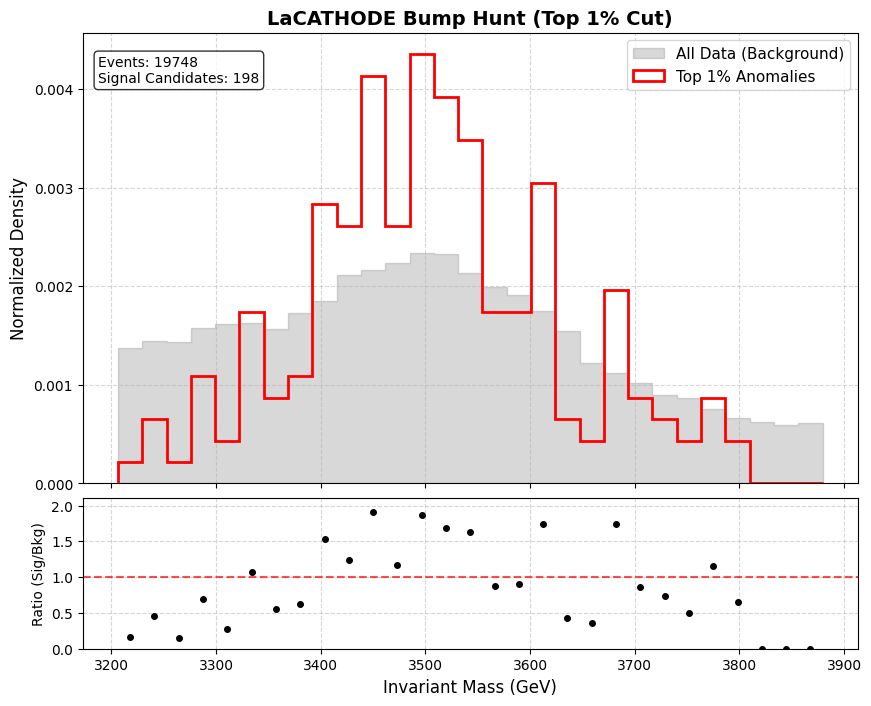

In [106]:
plot_anomaly_results(
    scores_file="./toolout/lacathode_trained_models/test_scores.npy",
    data_file="./toolout/lacathode_input_data/innerdata_test.npy"
)

In [ ]:
import numpy as np

# Load the file that crashed (The traceback says it was processing val_set)
# Depending on your split, this is likely innerdata_val.npy or outerdata_val.npy
# Let's check all of them just to be safe.
files = [
    './toolout/lacathode_input_data/innerdata_train.npy',
    './toolout/lacathode_input_data/outerdata_train.npy', 
    './toolout/lacathode_input_data/innerdata_val.npy'
]

# Feature names from your prep script
feature_names = [
    "m_jj", "n_particles", "dR", "mass_diff",          # 0-3
    "j1_px", "j1_py", "j1_pz", "j1_m", "j1_n", "j1_pT", "j1_t1", "j1_t2", "j1_t3", "j1_t4", "j1_t21", # 4-14
    "j2_px", "j2_py", "j2_pz", "j2_m", "j2_n", "j2_pT", "j2_t1", "j2_t2", "j2_t3", "j2_t4", "j2_t21"  # 15-25
]

print(f"{'File':<40} | {'Status':<10} | {'Bad Columns'}")
print("-" * 80)

for f in files:
    try:
        data = np.load(f)
        # Check for Infinite or NaN
        has_inf = np.isinf(data).any()
        has_nan = np.isnan(data).any()
        
        # Check for Zero Variance (Constant columns)
        # We only check columns that are not the label (last column)
        stds = np.std(data[:, :-1], axis=0)
        zero_variance_cols = np.where(stds == 0)[0]
        
        status = "❌ FAIL" if (has_inf or has_nan or len(zero_variance_cols) > 0) else "✅ OK"
        
        notes = []
        if has_inf: notes.append("Contains Infinity")
        if has_nan: notes.append("Contains NaN")
        if len(zero_variance_cols) > 0:
            names = [feature_names[i] for i in zero_variance_cols]
            notes.append(f"Const Cols: {names}")
            
        print(f"{f:<40} | {status:<10} | {', '.join(notes)}")
        
    except FileNotFoundError:
        print(f"{f:<40} | MISSING    | -")

## Blackbox Inference
Do the inference using lacathode_oracle.py using blackbox

In [ ]:
import_and_fastjet_path = os.path.join(cwd, "framework", "tools", "import_and_fastjet.py")

# Verify the script exists
if not os.path.isfile(import_and_fastjet_path):
    raise FileNotFoundError(f"Could not find import_and_fastjet.py at {import_and_fastjet_path}")

!py {import_and_fastjet_path} --input_file="events_LHCO2020_BlackBox1.h5" --no_label_input

Prepare inference data using lacathode_preperation.py in inference mode.

In [87]:
# Run the preparation over blackbox data
lacathode_preperation_path = os.path.join(cwd, "framework", "tools", "lacathode_preperation.py")

print(f"Running lacathode_preperation.py from {lacathode_preperation_path}")

# Verify the script exists
if not os.path.isfile(lacathode_preperation_path):
    raise FileNotFoundError(f"Could not find lacathode_preperation.py at {lacathode_preperation_path}")

# Run the script using the correct path
!py {lacathode_preperation_path} --input_unlabeled=toolout\\fastjet-output\\unlabeled_events.jsonl --run_mode=inference --output_dir ./toolout/blackbox1_data/

Running lacathode_preperation.py from c:\Bitirme\test2\framework\tools\lacathode_preperation.py
Running in INFERENCE mode (Using on real data)...
Saved inference files.
1. Train Flow on: ./toolout/blackbox1_data/outerdata_inference_train.npy
2. Detect anomalies in: ./toolout/blackbox1_data/innerdata_inference_train.npy
3. Validate on: ./toolout/blackbox1_data/outerdata_inference_val.npy and ./toolout/blackbox1_data/innerdata_inference_val.npy
4. Test on: ./toolout/blackbox1_data/outerdata_inference_test.npy and ./toolout/blackbox1_data/innerdata_inference_test.npy


In [120]:
inference_model_dir = os.path.join(cwd, "toolout", "lacathode_trained_models_2")

In [ ]:
lacathode_trainer_path = os.path.join(cwd, "framework", "tools", "lacathode_trainer.py")

# Verify the script exists
if not os.path.isfile(lacathode_trainer_path):
    raise FileNotFoundError(f"Could not find lacathode_trainer.py at {lacathode_trainer_path}")

# Run the script using the correct path
!py {lacathode_trainer_path} --data_dir=toolout/blackbox1_data --model_dir={inference_model_dir} --inference_mode

In [ ]:
lacathode_oracle_path = os.path.join(cwd, "framework", "tools", "lacathode_oracle.py")

!py {lacathode_oracle_path} --inference_file toolout/blackbox1_data/innerdata_inference_combined.npy --model_dir={inference_model_dir} --output_file blackbox1_inference_scores.npy

--- Initializing Oracle State ---
1. Loading Training Data (to restore scaler state)...
LaCATHODE Processor fitted (Logit for Taus, Standard for Mass/dR).
2. Loading Flow Model...
ConditionalNormalizingFlow has 280620 parameters
3. Calibrating Latent Space...
4. Loading Classifier...
Oracle Ready.

--- Running Inference on toolout/blackbox1_data/innerdata_inference_combined.npy ---
Loaded 26877 events.
Transforming to Latent Space...
Done! Scores saved to: toolout/blackbox1_trained_models/blackbox1_inference_scores.npy
Mean Score: 0.4691 (Higher > 0.5 = More Anomalous)


Verify that the output results are as expected.

--- Generating Corrected Bump Hunt Plot ---
Detected Mass in TeV. Converting to GeV for plotting...
Data Range: 3200.0 to 3899.9 GeV
Plot saved to final_bump_hunt_corrected.png
Data saved to final_bump_hunt_corrected_data.csv


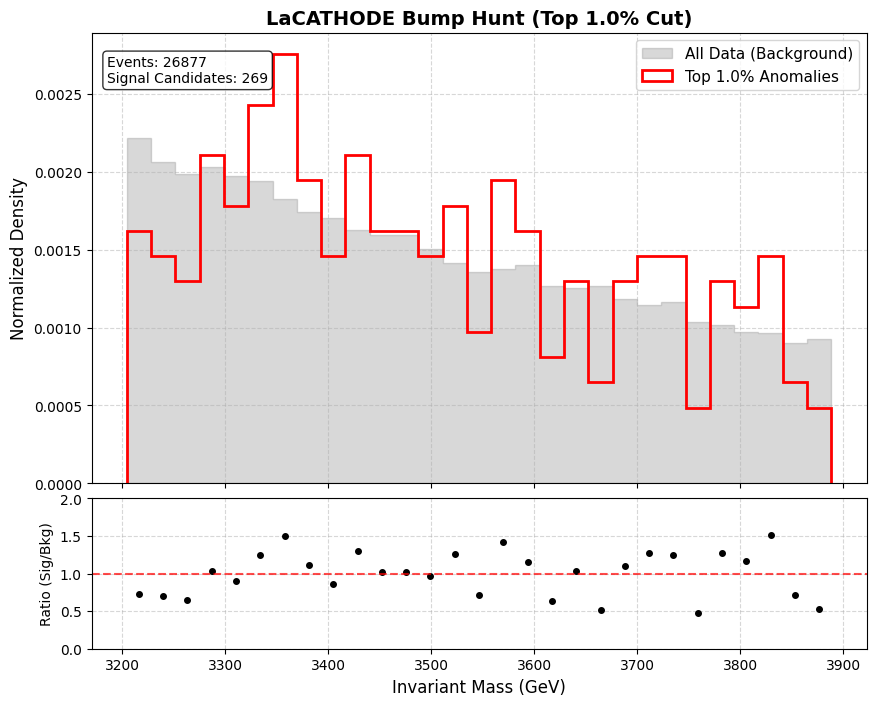

In [119]:
plot_anomaly_results(
    scores_file="./toolout/blackbox1_trained_models/blackbox1_inference_scores.npy",
    data_file="./toolout/blackbox1_data/innerdata_inference_combined.npy",
    top_percentile=99
)

Sanity check: Ensure that the lacathode_preperation provides correct values for inference mode.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os

# --- Configuration ---
# Ensure these match the output paths from your preparation script
inner_path = './toolout/lacathode_input_data/innerdata_inference.npy'
outer_path = './toolout/lacathode_input_data/outerdata_inference.npy'

# Feature names (based on lacathode_event_dictionary)
# Index 0 is m_jj, Index 9 is j1_pT, Index 14 is j1_tau21
feature_names = ["m_jj", "n_particles", "dR", "mass_diff", "j1_px", "j1_py", "j1_pz", "j1_m", "j1_n", "j1_pT", "j1_t1", "j1_t2", "j1_t3", "j1_t4", "j1_t21"]

if os.path.exists(inner_path) and os.path.exists(outer_path):
    # 1. Load the Data
    inner_data = np.load(inner_path)
    outer_data = np.load(outer_path)
    print(f"Loaded Data successfully.")
    print(f"Signal Region (Inner): {inner_data.shape[0]} events")
    print(f"Sideband (Outer):      {outer_data.shape[0]} events")

    # 2. Setup Plots
    fig, ax = plt.subplots(1, 2, figsize=(18, 6))

    # --- Plot 1: The Mass "Gap" Check (m_jj) ---
    # We combine them just to get the min/max for binning
    all_mass = np.concatenate([inner_data[:, 0], outer_data[:, 0]])
    bins_mass = np.linspace(all_mass.min(), all_mass.max(), 80)

    ax[0].hist(outer_data[:, 0], bins=bins_mass, alpha=0.6, label='Outer (Sideband)', color='tab:blue', density=True)
    ax[0].hist(inner_data[:, 0], bins=bins_mass, alpha=0.6, label='Inner (Signal Region)', color='tab:orange', density=True)
    ax[0].set_title("Sanity Check: Mass Window Cut")
    ax[0].set_xlabel("Invariant Mass $m_{jj}$ [TeV]")
    ax[0].set_ylabel("Normalized Density")
    ax[0].legend()
    ax[0].grid(True, alpha=0.3)

    # --- Plot 2: Kinematic Compatibility Check (Lead Jet pT) ---
    # We want to see if the Sideband is a good proxy for the Signal Region
    feature_idx = 9  # Leading Jet pT
    
    # Calculate sensible bins
    all_pt = np.concatenate([inner_data[:, feature_idx], outer_data[:, feature_idx]])
    bins_pt = np.linspace(np.percentile(all_pt, 1), np.percentile(all_pt, 99), 50)

    ax[1].hist(outer_data[:, feature_idx], bins=bins_pt, alpha=0.5, label='Outer', color='tab:blue', density=True)
    ax[1].hist(inner_data[:, feature_idx], bins=bins_pt, alpha=0.5, label='Inner', color='tab:orange', density=True, histtype='step', linewidth=2)
    ax[1].set_title(f"Kinematic Check: {feature_names[feature_idx]}")
    ax[1].set_xlabel("Leading Jet $p_T$ [GeV]")
    ax[1].legend()
    ax[1].grid(True, alpha=0.3)

    plt.show()

else:
    print(f"Files not found. Checked:\n{inner_path}\n{outer_path}")